In [1]:
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"))

In [2]:
%pip install decorator==5.0.9

import imp
import numpy as np
import pandas as pd
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics.pairwise import cosine_similarity
import matplotlib.pyplot as plt
import networkx as nx
import seaborn as sns

Note: you may need to restart the kernel to use updated packages.


In [3]:
# importing local modules

import sys
sys.path.append('../src/')

import text_cleanup.text_cleanup as thesisCleanUp
import preprocessing.text_preprocessing as thesisTextPreprocessing
import data.reader as thesisDataReader
import utils.utils as thesisUtils
import features.count_vectorizer.n_gram as thesisCountVectorizerNgramFeatures

imp.reload(thesisCleanUp)
imp.reload(thesisTextPreprocessing)
imp.reload(thesisDataReader)
imp.reload(thesisUtils)

<module 'utils.utils' from '../src/utils/utils.py'>

In [4]:
########
# In order to test new feature 
# you need to change only this functions
########
get_features = thesisCountVectorizerNgramFeatures.create_5_gram
get_zwickau_features = thesisCountVectorizerNgramFeatures.create_zwickau_5_gram
get_london_feature = thesisCountVectorizerNgramFeatures.create_london_5_gram

In [5]:
a_zwickau_corpus = thesisDataReader.get_zwickau_corpus()
b_london_corpus = thesisDataReader.get_london_corpus()

In [6]:
a_zwickau_df = get_zwickau_features()
a_zwickau_similarities = cosine_similarity(a_zwickau_df, a_zwickau_df)

b_london_df = get_london_feature()
b_london_similarities = cosine_similarity(b_london_df, b_london_df)

In [7]:
def show_similarities_data(similarities):
    for index, value in enumerate(similarities):
        max_indices = thesisUtils.get_n_indexes_of_max_values(value, 6)
        print('___ max similariry for paragraph: {} ___'.format(index))
        for i in max_indices:
            print('index: [{}] value: {}'.format(i, similarities[index][i]))
        print('average: {}'.format(np.average(value)))

        unique, counts = np.unique(value, return_counts=True)
        unique_dictionary = dict(zip(unique, counts))
        print('0 similarities: {}'.format(unique_dictionary.get(0.0)))

        print()

In [8]:
show_similarities_data(a_zwickau_similarities)

___ max similariry for paragraph: 0 ___
index: [274] value: 0.10318787407351646
index: [46] value: 0.11088035050664755
index: [49] value: 0.12038585308576921
index: [19] value: 0.12852260996084577
index: [321] value: 0.24743582965269678
index: [0] value: 1.0000000000000007
average: 0.018448978828560354
0 similarities: 138

___ max similariry for paragraph: 1 ___
index: [303] value: 0.1423167831953716
index: [280] value: 0.14989503589734773
index: [6] value: 0.16286499623581255
index: [283] value: 0.1665090164244914
index: [5] value: 0.18399246278156592
index: [1] value: 0.9999999999999998
average: 0.06940530226939232
0 similarities: 3

___ max similariry for paragraph: 2 ___
index: [280] value: 0.12421220232555817
index: [3] value: 0.12587960652472793
index: [182] value: 0.1271446012126843
index: [211] value: 0.14320461641842358
index: [5] value: 0.14508560157843162
index: [2] value: 1.0
average: 0.06127855804056884
0 similarities: 4

___ max similariry for paragraph: 3 ___
index: [183

___ max similariry for paragraph: 204 ___
index: [211] value: 0.17161935833116854
index: [182] value: 0.17536370280353333
index: [174] value: 0.17707112191504065
index: [201] value: 0.1771276079556899
index: [203] value: 0.21417986803856218
index: [204] value: 0.9999999999999988
average: 0.06335059036792197
0 similarities: 2

___ max similariry for paragraph: 205 ___
index: [231] value: 0.13868982608752367
index: [226] value: 0.14119979409528893
index: [109] value: 0.15059042432483818
index: [154] value: 0.16021201249311087
index: [52] value: 0.16164059602367709
index: [205] value: 1.0000000000000013
average: 0.05987472513566955
0 similarities: 6

___ max similariry for paragraph: 206 ___
index: [203] value: 0.15939417826583452
index: [162] value: 0.20148244333809556
index: [207] value: 0.2018524111405785
index: [134] value: 0.20542140952592838
index: [236] value: 0.23399597136343375
index: [206] value: 1.0000000000000007
average: 0.06465093253321355
0 similarities: 4

___ max similari

In [9]:
show_similarities_data(b_london_similarities)

___ max similariry for paragraph: 0 ___
index: [311] value: 0.14323445238732624
index: [272] value: 0.15609006393531624
index: [262] value: 0.15869974235603554
index: [266] value: 0.16000952151101935
index: [19] value: 0.20513217183267982
index: [0] value: 1.0
average: 0.022387004708839482
0 similarities: 163

___ max similariry for paragraph: 1 ___
index: [205] value: 0.15216576323659875
index: [118] value: 0.15398662349088105
index: [272] value: 0.1541572356221227
index: [275] value: 0.16467772879549436
index: [5] value: 0.1746461749163618
index: [1] value: 1.0000000000000002
average: 0.07545412763020934
0 similarities: None

___ max similariry for paragraph: 2 ___
index: [226] value: 0.12886521815843485
index: [274] value: 0.12923919406683296
index: [272] value: 0.13184834860063027
index: [311] value: 0.13346140024028832
index: [5] value: 0.14891578119315008
index: [2] value: 0.9999999999999998
average: 0.06757985944227413
0 similarities: 2

___ max similariry for paragraph: 3 ___
i

index: [74] value: 0.18429030912793037
index: [97] value: 0.2016318543360383
index: [87] value: 0.20708905273542136
index: [67] value: 0.21961449458757137
index: [68] value: 0.24732773840023672
index: [76] value: 0.9999999999999997
average: 0.08764368715299314
0 similarities: 1

___ max similariry for paragraph: 77 ___
index: [97] value: 0.209120199962299
index: [253] value: 0.21452527357157422
index: [227] value: 0.2152165828218283
index: [240] value: 0.23050893905413747
index: [48] value: 0.23187286801044515
index: [77] value: 1.0000000000000016
average: 0.09640073586257876
0 similarities: 2

___ max similariry for paragraph: 78 ___
index: [69] value: 0.19091579674699455
index: [161] value: 0.1948274101559755
index: [162] value: 0.19690222280385586
index: [88] value: 0.20272057863418538
index: [72] value: 0.24650350149477065
index: [78] value: 1.0
average: 0.09318684123128275
0 similarities: None

___ max similariry for paragraph: 79 ___
index: [163] value: 0.20376778014682856
index:

___ max similariry for paragraph: 188 ___
index: [158] value: 0.21942679183278394
index: [195] value: 0.22838664596511982
index: [222] value: 0.23098693409808307
index: [190] value: 0.23301253706707625
index: [192] value: 0.24846185355904665
index: [188] value: 1.0000000000000004
average: 0.09314743387536632
0 similarities: 1

___ max similariry for paragraph: 189 ___
index: [151] value: 0.12380880017558583
index: [157] value: 0.12690402765898962
index: [85] value: 0.12744432378545775
index: [80] value: 0.1280618085455473
index: [205] value: 0.1634187649815121
index: [189] value: 1.0000000000000013
average: 0.07131944546027315
0 similarities: 1

___ max similariry for paragraph: 190 ___
index: [195] value: 0.22493680349480055
index: [188] value: 0.23301253706707625
index: [191] value: 0.2376624122100068
index: [220] value: 0.2418587215370245
index: [164] value: 0.2510498831303457
index: [190] value: 0.9999999999999984
average: 0.09840962501602667
0 similarities: None

___ max similarir

index: [244] value: 0.9999999999999989
average: 0.06975778022330563
0 similarities: 3

___ max similariry for paragraph: 245 ___
index: [27] value: 0.15538765128904847
index: [192] value: 0.16834336185233534
index: [289] value: 0.16865139839308974
index: [88] value: 0.17526329387348824
index: [14] value: 0.20631568826852975
index: [245] value: 1.0000000000000004
average: 0.08775360250103272
0 similarities: None

___ max similariry for paragraph: 246 ___
index: [56] value: 0.14608346988656326
index: [162] value: 0.14683241730602203
index: [261] value: 0.14807003325457388
index: [289] value: 0.16029154912895766
index: [291] value: 0.16534103790563526
index: [246] value: 0.9999999999999986
average: 0.07719838665611943
0 similarities: 1

___ max similariry for paragraph: 247 ___
index: [35] value: 0.2075954390512078
index: [69] value: 0.20930320994309484
index: [252] value: 0.23900054644894392
index: [251] value: 0.28474739872574983
index: [250] value: 0.4214636152117625
index: [247] value

In [10]:
def get_max_similarity_per_p(similarities):
    res = []
    for index, value in enumerate(similarities):
        max_indices = thesisUtils.get_n_indexes_of_max_values(value, 6)
        max_indices_without_self = max_indices[:-1]
        max_similarity = value[max_indices_without_self[-1]]
        res.append(max_similarity)
    return res

In [11]:
a_zwickau_max_similarity_per_p = get_max_similarity_per_p(a_zwickau_similarities)
b_london_max_similarity_per_p = get_max_similarity_per_p(b_london_similarities)


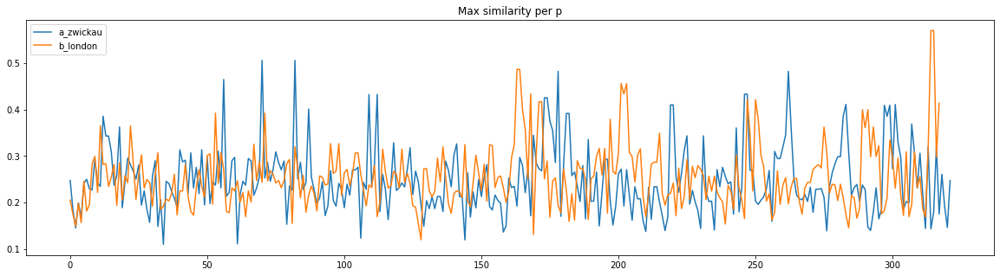

In [12]:
%matplotlib inline
fig, ax = plt.subplots(figsize=(20, 5))
ax.plot(a_zwickau_max_similarity_per_p, label="a_zwickau")
ax.plot(b_london_max_similarity_per_p, label="b_london")
ax.legend()
plt.title('Max similarity per p')
plt.show()

In [13]:
def cross_version_similarity(version_1_corpus, version_2_corpus):
    res = []
    for i, p in enumerate(version_1_corpus):
        temp_corpus = [p] + version_2_corpus
        df_features = get_features(temp_corpus)
        temp_similarities = cosine_similarity(df_features, df_features)
        res.append(temp_similarities[0])
    return res

In [14]:
a_zwickau_b_london_similarities = cross_version_similarity(a_zwickau_corpus, b_london_corpus)
b_london_a_zwickau_similarities = cross_version_similarity(b_london_corpus, a_zwickau_corpus)

In [15]:
show_similarities_data(a_zwickau_b_london_similarities)

___ max similariry for paragraph: 0 ___
index: [267] value: 0.10388150415966657
index: [21] value: 0.1190488053657645
index: [1] value: 0.140028008402801
index: [9] value: 0.16884185384856418
index: [20] value: 0.2202192460215467
index: [0] value: 1.0000000000000004
average: 0.01971360258510646
0 similarities: 131

___ max similariry for paragraph: 1 ___
index: [314] value: 0.14879590519303287
index: [273] value: 0.1498620466413382
index: [276] value: 0.1745249383533081
index: [6] value: 0.1753939625545286
index: [2] value: 0.8408213630139321
index: [0] value: 0.9999999999999999
average: 0.07676187803557634
0 similarities: None

___ max similariry for paragraph: 2 ___
index: [227] value: 0.12617115563004014
index: [275] value: 0.1269106203756679
index: [312] value: 0.12954896972551222
index: [6] value: 0.1441571994470439
index: [3] value: 0.9262515096774957
index: [0] value: 1.0000000000000007
average: 0.06749259062011803
0 similarities: 2

___ max similariry for paragraph: 3 ___
index

index: [239] value: 0.7427055857520557
index: [0] value: 1.0
average: 0.07966324650866244
0 similarities: 1

___ max similariry for paragraph: 235 ___
index: [49] value: 0.13363062095621223
index: [238] value: 0.1369530008754814
index: [78] value: 0.14058152327977294
index: [214] value: 0.14708710135363806
index: [240] value: 0.8679102202353294
index: [0] value: 0.9999999999999989
average: 0.058159096501787626
0 similarities: 2

___ max similariry for paragraph: 236 ___
index: [167] value: 0.22839439762939748
index: [78] value: 0.24006987760674817
index: [212] value: 0.2518674605928887
index: [105] value: 0.31945378695479143
index: [241] value: 0.8276592854261455
index: [0] value: 0.9999999999999998
average: 0.08300192203487401
0 similarities: 4

___ max similariry for paragraph: 237 ___
index: [228] value: 0.19447017103329856
index: [241] value: 0.1970862126243528
index: [219] value: 0.2010955363163659
index: [250] value: 0.2309022817928611
index: [242] value: 0.813582670910558
index:

In [16]:
show_similarities_data(b_london_a_zwickau_similarities)

___ max similariry for paragraph: 0 ___
index: [322] value: 0.1385917857350474
index: [1] value: 0.140028008402801
index: [219] value: 0.14817951938361826
index: [281] value: 0.15233958964458147
index: [275] value: 0.15894111747616882
index: [0] value: 1.0
average: 0.023788729626058013
0 similarities: 177

___ max similariry for paragraph: 1 ___
index: [281] value: 0.1526173570563527
index: [284] value: 0.15752393115309987
index: [7] value: 0.15759821471244925
index: [6] value: 0.18158154167915874
index: [2] value: 0.8408213630139318
index: [0] value: 1.0
average: 0.07134860058221046
0 similarities: 3

___ max similariry for paragraph: 2 ___
index: [282] value: 0.13903322435658227
index: [281] value: 0.14009207162737214
index: [6] value: 0.14739755966327298
index: [212] value: 0.15019182217151147
index: [3] value: 0.926251509677495
index: [0] value: 0.9999999999999998
average: 0.06661780483750523
0 similarities: 4

___ max similariry for paragraph: 3 ___
index: [265] value: 0.157320861

index: [156] value: 0.2241514000686619
index: [128] value: 0.46521981604818324
index: [0] value: 0.9999999999999988
average: 0.06951975669493789
0 similarities: 3

___ max similariry for paragraph: 123 ___
index: [300] value: 0.22119568049628913
index: [55] value: 0.23357524207589964
index: [183] value: 0.2392202605696075
index: [170] value: 0.25271323061857875
index: [129] value: 0.5232732523111149
index: [0] value: 1.0000000000000002
average: 0.10177616006293491
0 similarities: 2

___ max similariry for paragraph: 124 ___
index: [172] value: 0.13908843770674095
index: [204] value: 0.14290535654155875
index: [33] value: 0.16132054153739595
index: [133] value: 0.1793916598518603
index: [130] value: 0.727211379663978
index: [0] value: 1.0
average: 0.05051238402953946
0 similarities: 6

___ max similariry for paragraph: 125 ___
index: [87] value: 0.16629704635651543
index: [119] value: 0.17084149002279997
index: [178] value: 0.17717695970216546
index: [88] value: 0.1828434139251261
index

0 similarities: None

___ max similariry for paragraph: 189 ___
index: [89] value: 0.1323131099168461
index: [65] value: 0.13780498825784082
index: [26] value: 0.13794852900734086
index: [186] value: 0.14655959062380952
index: [199] value: 0.6056136591989474
index: [0] value: 1.0000000000000013
average: 0.0685350903410838
0 similarities: 1

___ max similariry for paragraph: 190 ___
index: [124] value: 0.19807712792352616
index: [201] value: 0.23763499751489503
index: [176] value: 0.24130482516261947
index: [170] value: 0.2600510312525167
index: [200] value: 0.4040522881522958
index: [0] value: 0.9999999999999984
average: 0.0910975758990769
0 similarities: 1

___ max similariry for paragraph: 191 ___
index: [175] value: 0.21888628137652785
index: [183] value: 0.21937761540916473
index: [174] value: 0.24304370204728187
index: [170] value: 0.2518573881612004
index: [201] value: 0.7708571832569798
index: [0] value: 0.9999999999999991
average: 0.10832139262192488
0 similarities: 1

___ max 

In [17]:
a_zwickau_b_london_max_similarity_per_p = get_max_similarity_per_p(a_zwickau_b_london_similarities)
b_london_a_zwickau_max_similarity_per_p = get_max_similarity_per_p(b_london_a_zwickau_similarities)

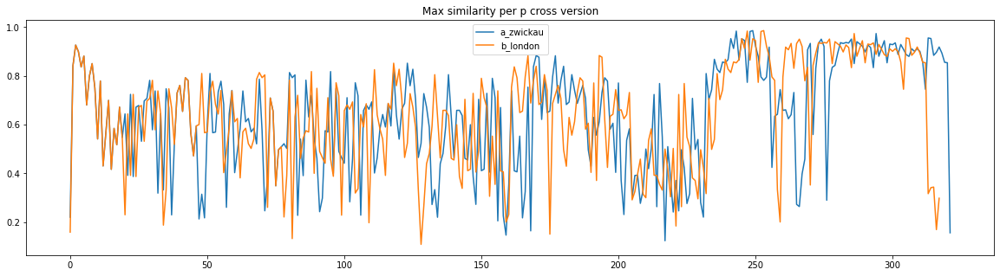

In [18]:
fig, ax = plt.subplots(figsize=(20, 5))
ax.plot(a_zwickau_b_london_max_similarity_per_p, label="a_zwickau")
ax.plot(b_london_a_zwickau_max_similarity_per_p, label="b_london")
ax.legend()
plt.title('Max similarity per p cross version')
plt.show()

In [19]:
def create_G_of_similaritis(similarities):
    G = nx.Graph()
    total = 0
    for index, value in enumerate(similarities):
        max_indices = thesisUtils.get_n_indexes_of_max_values(value, 2)
        max_indices_without_self = max_indices[:-1]
        G.add_node(index) # node himself
        total += len(max_indices_without_self)
        for n in max_indices_without_self:
            G.add_node(n)
            weight = similarities[index][n]
            G.add_weighted_edges_from([(index, n, weight)])
    print(total)
    return G

In [20]:
def show_G(G):
    %matplotlib notebook

    fig = plt.figure(figsize=(10, 10))
    fig.canvas.manager.full_screen_toggle()

    pos=nx.spring_layout(G)
    nx.draw(
        G, 
        pos,
        with_labels=True, 
    )
    fig.show()

In [21]:
len(a_zwickau_similarities[0])

322

In [22]:
a_zwickau_G = create_G_of_similaritis(a_zwickau_similarities)
b_london_G = create_G_of_similaritis(b_london_similarities)

322
318


In [23]:
a_zwickau_G
nx.readwrite.graphml.write_graphml(a_zwickau_G, "zwickau_inner.graphml")

In [24]:
print(len(list(nx.connected_components(a_zwickau_G))))
print(len(list(nx.connected_components(b_london_G))))

44
45


In [25]:
a_zwickau_sorted_degree = sorted(a_zwickau_G.degree, key=lambda x: x[1], reverse=True)
print(a_zwickau_sorted_degree)

# sum(map(lambda node: node[1], a_zwickau_sorted_degree))
sum(list(map(lambda node: node[1], a_zwickau_sorted_degree))) / 2

[(87, 14), (299, 13), (169, 11), (283, 10), (280, 7), (105, 7), (152, 6), (246, 6), (5, 5), (301, 5), (70, 5), (219, 5), (262, 5), (18, 4), (64, 4), (297, 4), (123, 4), (111, 4), (88, 4), (249, 4), (184, 4), (225, 4), (203, 4), (236, 4), (174, 4), (182, 4), (6, 3), (12, 3), (54, 3), (48, 3), (281, 3), (52, 3), (71, 3), (78, 3), (84, 3), (240, 3), (92, 3), (185, 3), (126, 3), (255, 3), (176, 3), (279, 3), (196, 3), (221, 3), (287, 3), (288, 3), (290, 3), (17, 2), (9, 2), (46, 2), (13, 2), (14, 2), (15, 2), (21, 2), (25, 2), (23, 2), (24, 2), (309, 2), (104, 2), (30, 2), (129, 2), (43, 2), (35, 2), (53, 2), (51, 2), (69, 2), (58, 2), (117, 2), (101, 2), (77, 2), (74, 2), (86, 2), (109, 2), (171, 2), (98, 2), (99, 2), (112, 2), (110, 2), (114, 2), (118, 2), (121, 2), (132, 2), (131, 2), (318, 2), (138, 2), (137, 2), (149, 2), (155, 2), (167, 2), (201, 2), (165, 2), (166, 2), (175, 2), (173, 2), (178, 2), (180, 2), (191, 2), (267, 2), (195, 2), (197, 2), (200, 2), (242, 2), (213, 2), (214,

278.0

In [26]:
b_london_sorted_degree = sorted(b_london_G.degree, key=lambda x: x[1], reverse=True)
print(b_london_sorted_degree)

[(291, 11), (164, 10), (205, 9), (275, 8), (80, 8), (272, 7), (250, 7), (192, 6), (162, 5), (25, 5), (314, 5), (163, 5), (313, 5), (5, 4), (144, 4), (85, 4), (51, 4), (98, 4), (235, 4), (185, 4), (130, 4), (293, 4), (240, 4), (271, 3), (317, 3), (46, 3), (22, 3), (26, 3), (73, 3), (97, 3), (289, 3), (247, 3), (36, 3), (273, 3), (315, 3), (71, 3), (67, 3), (157, 3), (74, 3), (82, 3), (274, 3), (151, 3), (153, 3), (227, 3), (225, 3), (160, 3), (171, 3), (178, 3), (197, 3), (222, 3), (282, 3), (20, 2), (8, 2), (79, 2), (9, 2), (16, 2), (14, 2), (103, 2), (18, 2), (23, 2), (27, 2), (31, 2), (55, 2), (92, 2), (37, 2), (43, 2), (48, 2), (253, 2), (53, 2), (228, 2), (59, 2), (62, 2), (69, 2), (70, 2), (83, 2), (96, 2), (194, 2), (106, 2), (102, 2), (105, 2), (104, 2), (207, 2), (152, 2), (147, 2), (111, 2), (123, 2), (121, 2), (115, 2), (310, 2), (303, 2), (134, 2), (230, 2), (140, 2), (261, 2), (158, 2), (166, 2), (165, 2), (168, 2), (172, 2), (183, 2), (188, 2), (190, 2), (193, 2), (198, 2)

In [27]:
a_zwickau_strongly_connected_nodes = [(node, degree) for node, degree in a_zwickau_sorted_degree if degree >= 10]
print(len(a_zwickau_strongly_connected_nodes))
print(a_zwickau_strongly_connected_nodes)

4
[(87, 14), (299, 13), (169, 11), (283, 10)]


In [28]:
b_london_strongly_connected_nodes = [(node, degree) for node, degree in b_london_sorted_degree if degree >= 10]
print(len(b_london_strongly_connected_nodes))
print(b_london_strongly_connected_nodes)

2
[(291, 11), (164, 10)]


In [29]:
nx.readwrite.graphml.write_graphml(a_zwickau_G, "a_zwickau_G.graphml")

<IPython.core.display.Javascript object>


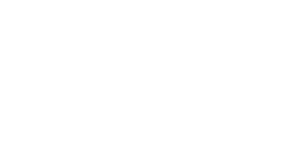

In [30]:
show_G(a_zwickau_G)

<IPython.core.display.Javascript object>


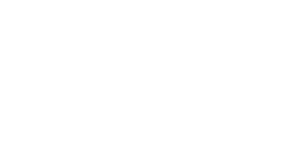

In [31]:
show_G(b_london_G)

In [32]:
%matplotlib inline
fig, axes = plt.subplots(318, 1, figsize=(20,900))
zwickau_inner_similarities_df = pd.DataFrame(a_zwickau_similarities)
london_inner_similarities_df = pd.DataFrame(b_london_similarities)

for i, ax in enumerate(axes.ravel()):
    ax.set_title(f'paragraph {i}')
    
    if i in list(zwickau_inner_similarities_df.index):
        y_1 = zwickau_inner_similarities_df.iloc[i, :]
        ax.plot(y_1, color='orange', label='a_zwickau')
    
    if i in list(london_inner_similarities_df.index):
        y_2 = london_inner_similarities_df.iloc[i, :]
        ax.plot(y_2, label='b_london')
        
    ax.grid()
    ax.set_ylim([0,1])
    ax.legend()

plt.show()

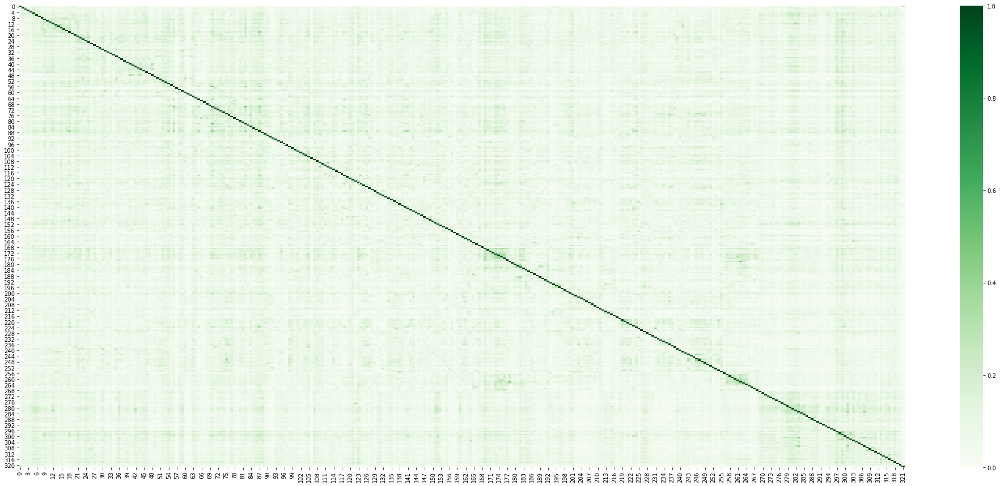

In [33]:
plt.figure(figsize = (35,15))
sns.heatmap(zwickau_inner_similarities_df, cmap="Greens") # font size

plt.show()

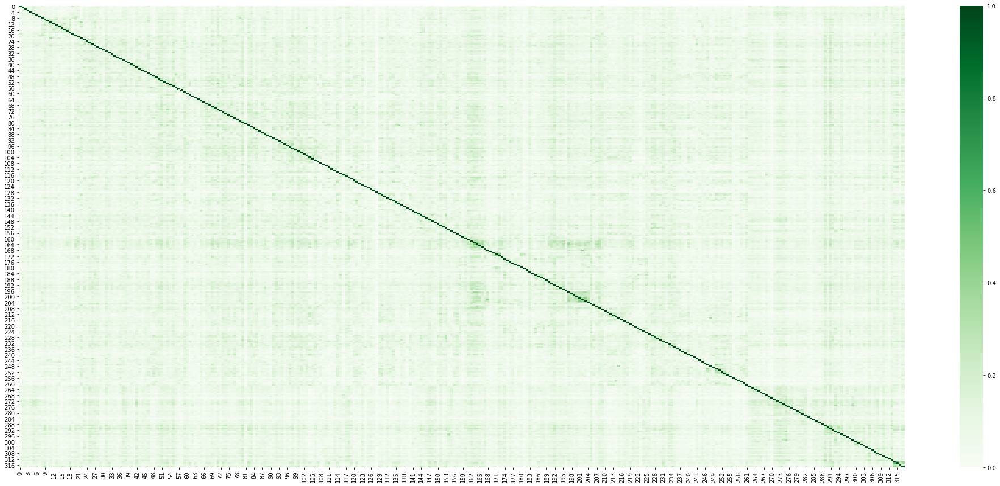

In [34]:
plt.figure(figsize = (35,15))
sns.heatmap(london_inner_similarities_df, cmap="Greens") # font size

plt.show()

In [35]:
%matplotlib inline
fig, axes = plt.subplots(318, 1, figsize=(20,900))
zwickau_london_similarities_df = pd.DataFrame(a_zwickau_b_london_similarities)
london_zwickau_similarities_df = pd.DataFrame(b_london_a_zwickau_similarities)

for i, ax in enumerate(axes.ravel()):
    ax.set_title(f'paragraph {i}')
    
    if i in list(zwickau_london_similarities_df.index):
        y_1 = zwickau_london_similarities_df.iloc[i,:]
        ax.plot(y_1, color='orange', label='a_zwickau')
    
    if i in list(london_zwickau_similarities_df.index):
        y_2 = london_zwickau_similarities_df.iloc[i,:]
        ax.plot(y_2, label='b_london')
        
    ax.grid()
    ax.set_ylim([0,1])
    ax.legend()

plt.show()

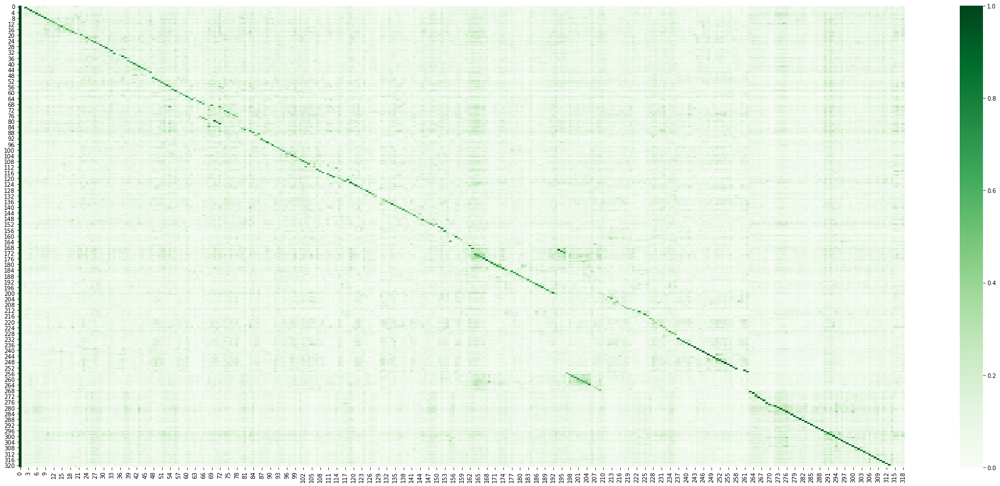

In [36]:
plt.figure(figsize = (35,15))
sns.heatmap(zwickau_london_similarities_df, cmap="Greens") # font size

plt.show()

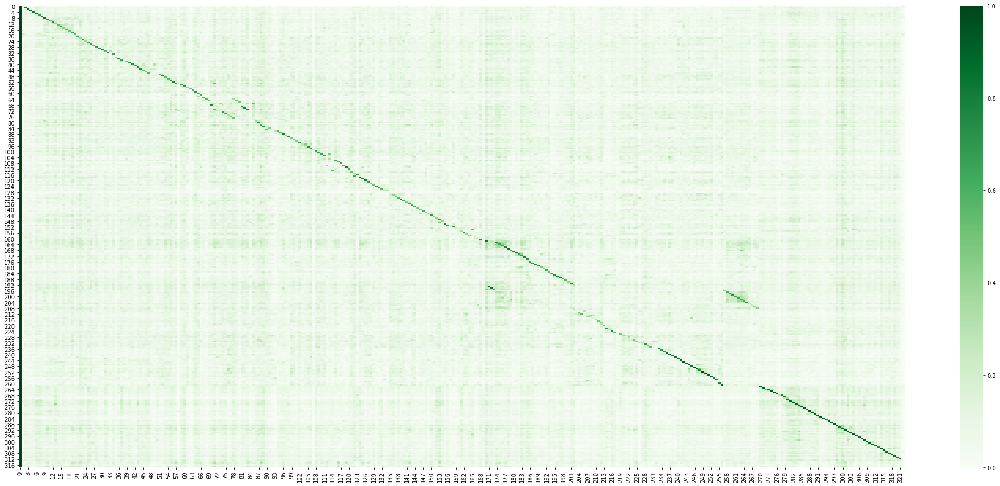

In [37]:
plt.figure(figsize = (35,15))
sns.heatmap(london_zwickau_similarities_df, cmap="Greens") # font size

plt.show()